#Customer Segmentation

## Data Preparation & Understanding

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
pd.set_option("display.max_columns", None) # show all columns
pd.set_option("display.max_rows", None) # show all rows

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Final Project Dibimbing/sample_dataset.csv')
df.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic
1,26381,Michelle,Phelps,NaN,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Customer ID         50000 non-null  int64  
 1   Name                50000 non-null  object 
 2   Surname             50000 non-null  object 
 3   Gender              44953 non-null  object 
 4   Birthdate           50000 non-null  object 
 5   Transaction Amount  50000 non-null  float64
 6   Date                50000 non-null  object 
 7   Merchant Name       50000 non-null  object 
 8   Category            50000 non-null  object 
dtypes: float64(1), int64(1), object(7)
memory usage: 3.4+ MB


Based on informastion and tabel from dataset, there's some description from that tabel or dataset. Here's the explanation from that dataset :

- Customer ID : The unique identifier for each customer.
- Name : The customer's name.
- Surname : The customer's last name.
- Gender : The gender of the customer.
- Birthdate : The customer's date of birth.
- Transaction Amount : The amount of the transaction. ($)
- Date : The date of the transaction.
- Merchant Name :The name of the merchant where the transaction was made.
- Category : The category of the transaction.

Based on that explanation, we're have some goals on this dataset. The goals that we're gonna hope was the determined of typical customer based on their transaction with some of categorical from this dataset. The purpose in this goal was we're gonna help the company to know every single customer so that the company have a previous step before it would be happend.

# Feature Engginering / Data Cleaning

## 1. Duplicate Handling

In [ ]:
len(df.drop_duplicates()) / len(df)
#jika output dari code di cell ini tidak bernilai 1 maka terdapat duplikat

1.0

No Any Duplicate

## 2. Missing Value Handling
## Identifying missing value

In [ ]:
df.isnull().sum()

,0
Customer ID,0
Name,0
Surname,0
Gender,5047
Birthdate,0
Transaction Amount,0
Date,0
Merchant Name,0
Category,0


In [ ]:
for column in df.columns:
    print(f"============= {column} =================")
    display(df[column].value_counts())
    print()

============= Customer ID =================


,count
Customer ID,
91701,1
728409,1
665098,1
582602,1
366368,1
7504,1
855285,1
286982,1
69254,1



============= Name =================


,count
Name,
Michael,1167
David,761
John,749
James,730
Christopher,711
Jennifer,694
Robert,682
Matthew,546
William,512



============= Surname =================


,count
Surname,
Smith,1095
Johnson,824
Williams,695
Brown,665
Jones,631
Davis,503
Miller,496
Garcia,386
Anderson,383



============= Gender =================


,count
Gender,
F,22713
M,22240



============= Birthdate =================


,count
Birthdate,
1954-11-01,914
1983-10-25,910
2005-10-19,904
1956-10-31,896
2004-10-19,894
2001-10-20,887
1953-11-01,887
1959-10-31,886
1999-10-21,886



============= Transaction Amount =================


,count
Transaction Amount,
68.89,9
47.78,8
64.94,8
30.16,8
75.21,8
81.26,7
49.75,7
48.42,7
42.46,7



============= Date =================


,count
Date,
2023-06-30,200
2023-07-23,199
2023-09-08,198
2023-03-18,198
2023-01-07,197
2023-04-19,196
2023-05-18,195
2023-07-21,195
2023-05-08,195



============= Merchant Name =================


,count
Merchant Name,
Smith Ltd,69
Smith Group,65
Smith PLC,65
Smith Inc,60
Smith LLC,60
Smith and Sons,56
Johnson PLC,55
Williams LLC,54
Johnson LLC,53



============= Category =================


,count
Category,
Restaurant,8413
Market,8382
Travel,8377
Electronics,8324
Clothing,8261
Cosmetic,8243


In [ ]:
df[df.isna().any(axis=1)]

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
1,26381,Michelle,Phelps,NaN,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
6,124681,Thomas,Shaw,NaN,1976-10-26,145.94,2023-08-30,"Evans, Griffin and Torres",Cosmetic
17,793150,Chad,Reese,NaN,1962-10-30,475.82,2023-04-22,Hughes Inc,Market
21,943548,Daniel,Pitts,NaN,1995-10-22,39.87,2023-06-01,Shaw-Elliott,Clothing
24,111696,Anthony,Miller,NaN,1991-10-23,108.30,2023-06-14,"Nguyen, Patel and Dudley",Cosmetic
29,726547,Adam,Hansen,NaN,1966-10-29,94.69,2023-09-13,Johnson-Campbell,Cosmetic
42,599093,Thomas,Salas,NaN,1956-10-31,57.83,2023-08-06,Jimenez Inc,Electronics
44,261654,Kevin,Harris,NaN,1977-10-26,147.43,2023-06-11,Thomas LLC,Cosmetic
50,801291,Sydney,Spencer,NaN,1980-10-25,1374.86,2023-03-19,Johnson LLC,Travel
62,982485,Leslie,Campbell,NaN,1982-10-25,139.20,2023-08-04,"White, Hensley and Hayes",Market


After we analyze that data, there's no any abnormal data of column.  It's just only having a missing value on gender. So that's means, we're gonna check the precentage of that gender for determining who's gonna be a object or numerical data.

In [ ]:
# Menghitung persentase nilai NaN di kolom gender
100 * len(df[df['Gender'].isna()]) / len(df)

10.094

Based on percentage, the data is less than 20%, so that means we're gonna handling with the modus. The reason using that modus because the type object of that column is string / object

In [ ]:
#Mode imputation Untuk gender
mode_gender = df[~df['Gender'].isna()]['Gender'].mode()[0]
mode_gender

'F'

In [ ]:
#implement missing value imputation to EDA, from gender mode value in dataset
df['Gender'] = df['Gender'].apply(lambda x: mode_gender if pd.isna(x) else x)

In [ ]:
df.isna().sum()

,0
Customer ID,0
Name,0
Surname,0
Gender,0
Birthdate,0
Transaction Amount,0
Date,0
Merchant Name,0
Category,0


In [ ]:
df.head(10)

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics
5,576539,Monica,Bartlett,F,2001-10-20,99.14,2023-08-24,"Tran, Torres and Joyce",Cosmetic
6,124681,Thomas,Shaw,F,1976-10-26,145.94,2023-08-30,"Evans, Griffin and Torres",Cosmetic
7,521807,Kelsey,Pena,F,1968-10-28,161.39,2023-02-08,Miller PLC,Cosmetic
8,504238,Denise,Porter,M,1957-10-31,77.73,2023-01-12,Jackson-Morgan,Restaurant
9,583532,Alexander,Richardson,F,1974-10-27,142.85,2023-06-07,"Blake, Mays and Anderson",Clothing


## 3. Outlier Handling

In [ ]:
# untuk plot Q-Q
import scipy.stats as stats

In [ ]:
numeric_columns = df.select_dtypes(include=['number']).columns
numeric_columns

Index(['Customer ID', 'Transaction Amount'], dtype='object')

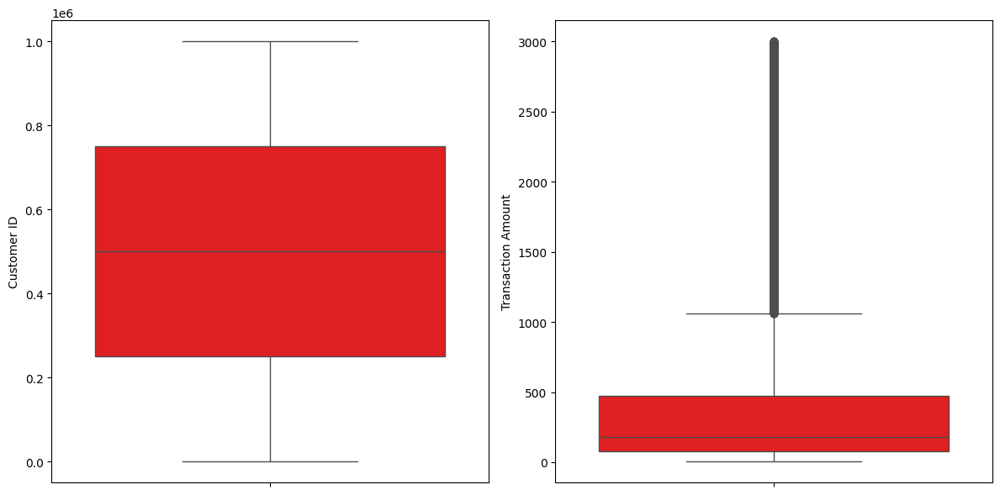

In [ ]:
# adjust the figure size for better readability
plt.figure(figsize=(12,6))

# plotting
for i in range(0, len(numeric_columns)):
    plt.subplot(1, len(numeric_columns), i+1)
    sns.boxplot(y=df[numeric_columns[i]], color='red')
    plt.tight_layout()

In [ ]:
# check the outlier full profile
for i in numeric_columns:
  outlier = df[i].min()
  a = df[df[i] == outlier]

a

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
37438,368447,Jared,Allen,M,1957-10-31,5.01,2023-02-06,"Garcia, Thompson and Hull",Market


After we check the outlier, there's one outlier but the box of outlier is still clear. So, we don't need handle on it.

In [ ]:
df.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics


# Data Manipulation / EDA

In [ ]:
df_transaction = df.copy()
df_transaction.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics



## Filtering

1. Which the highest amount of merchant name that categorized as travel and also above of transaction amount ?

In [ ]:
df_transaction['Transaction Amount'].mean()

np.float64(442.1192394)

In [ ]:
df_filter = df_transaction[(df_transaction['Transaction Amount'] > df_transaction['Transaction Amount'].mean()) & (df_transaction['Category'] == 'Travel')]
df_filter.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel
10,924841,Kimberly,Ball,M,1976-10-26,928.68,2023-02-11,"Miller, Walker and Bond",Travel
19,401993,Steven,Smith,M,1999-10-21,1468.14,2023-05-14,"Thompson, Lopez and Mason",Travel
27,517389,Brian,Jones,F,1956-10-31,781.85,2023-03-30,Dorsey Inc,Travel
28,744599,William,Contreras,F,2003-10-20,1479.49,2023-04-15,"Fuller, Jones and White",Travel


In [ ]:
Barang = df_filter['Merchant Name'].value_counts().sort_values(ascending=False).reset_index().head(10)
Barang # menampilkan tabel yang mana menampilkan tipe barang dan jumlah barang berdasarkan yang sudah difilter dari atas

,Merchant Name,count
0,Johnson PLC,15
1,Smith PLC,13
2,Smith Inc,12
3,Johnson Ltd,11
4,Johnson LLC,10
5,Jones PLC,10
6,Williams LLC,10
7,Smith Ltd,10
8,Smith LLC,10
9,Jones Ltd,9


In [ ]:
Barang.rename(
    columns = {
        'count': 'Quantity',
    }, inplace = True
)
Barang # mereplace nama count dgn quantity

,Merchant Name,Quantity
0,Johnson PLC,15
1,Smith PLC,13
2,Smith Inc,12
3,Johnson Ltd,11
4,Johnson LLC,10
5,Jones PLC,10
6,Williams LLC,10
7,Smith Ltd,10
8,Smith LLC,10
9,Jones Ltd,9


/tmp/ipython-input-23-144606485.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Quantity', y='Merchant Name', data = Barang, palette='viridis')


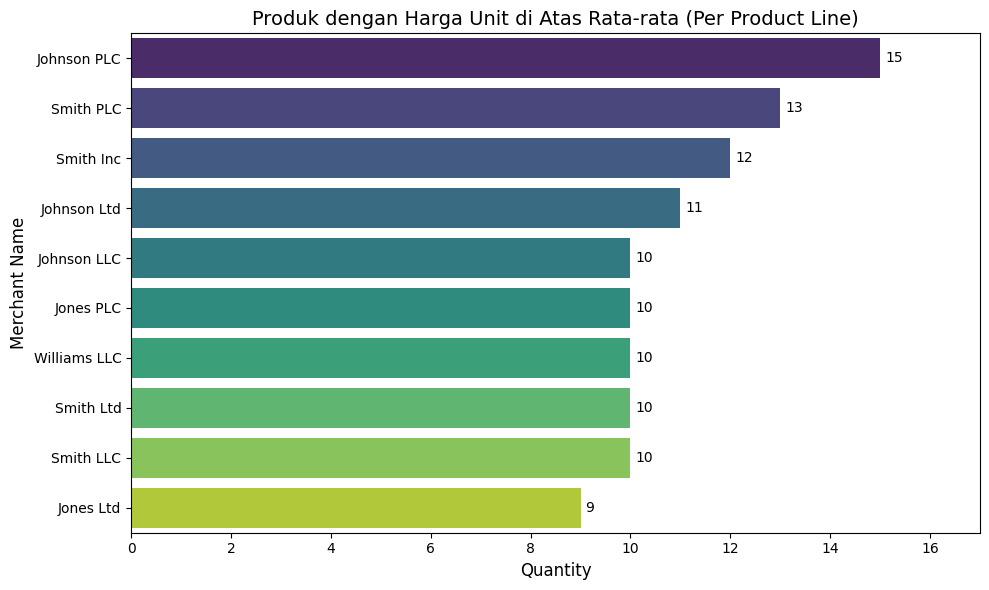

In [ ]:
# Visualisasi dalam bentuk bar chart
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Quantity', y='Merchant Name', data = Barang, palette='viridis')

# Tambahkan angka di atas bar dengan format angka
for i,(value,name) in enumerate(zip(Barang['Quantity'],Barang['Quantity'])):
  ax.text(value + 0.1, i, f'{value}', color ='black', va = 'center', fontsize = 10)

# Tambahkan judul dan label
plt.title('Produk dengan Harga Unit di Atas Rata-rata (Per Product Line)', fontsize=14)
plt.xlabel('Quantity', fontsize=12)
plt.ylabel('Merchant Name', fontsize=12)

# Atur skala sumbu X agar lebih proporsional
plt.xlim(0, max(Barang['Quantity']) + 2)
#plt.xticks(rotation=45)

plt.tight_layout()  # Menghindari teks terpotong
plt.show()

##Working With Date

2. in which month that the total transaction has the highest average amount ?

In [ ]:
df_transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Customer ID         50000 non-null  int64  
 1   Name                50000 non-null  object 
 2   Surname             50000 non-null  object 
 3   Gender              50000 non-null  object 
 4   Birthdate           50000 non-null  object 
 5   Transaction Amount  50000 non-null  float64
 6   Date                50000 non-null  object 
 7   Merchant Name       50000 non-null  object 
 8   Category            50000 non-null  object 
dtypes: float64(1), int64(1), object(7)
memory usage: 3.4+ MB


In [ ]:
df_transaction['Date']= pd.to_datetime(df_transaction['Date'])
df_transaction['Birthdate']= pd.to_datetime(df_transaction['Birthdate'])
df_transaction['DayOfWeek'] = df_transaction['Date'].dt.day_name()
df_transaction['Year'] = df_transaction['Date'].dt.year
df_transaction['Year_People'] = df_transaction['Birthdate'].dt.year
df_transaction['Day'] = df_transaction['Date'].dt.day
df_transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Customer ID         50000 non-null  int64         
 1   Name                50000 non-null  object        
 2   Surname             50000 non-null  object        
 3   Gender              50000 non-null  object        
 4   Birthdate           50000 non-null  datetime64[ns]
 5   Transaction Amount  50000 non-null  float64       
 6   Date                50000 non-null  datetime64[ns]
 7   Merchant Name       50000 non-null  object        
 8   Category            50000 non-null  object        
 9   DayOfWeek           50000 non-null  object        
 10  Year                50000 non-null  int32         
 11  Year_People         50000 non-null  int32         
 12  Day                 50000 non-null  int32         
dtypes: datetime64[ns](2), float64(1), int32(3), in

In [ ]:
df_transaction['Month Name'] = pd.DatetimeIndex(df_transaction['Date']).month_name()

In [ ]:
df_transaction['Day Month'] = df_transaction['Month Name'].astype(str) + ' ' + df_transaction['Day'].astype(str)
df_transaction.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category,DayOfWeek,Year,Year_People,Day,Month Name,Day Month
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic,Monday,2023,2002,3,April,April 3
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel,Monday,2023,1985,17,July,July 17
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing,Wednesday,2023,1981,20,September,September 20
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Wednesday,2023,1977,11,January,January 11
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics,Tuesday,2023,1951,13,June,June 13


In [ ]:
df_transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Customer ID         50000 non-null  int64         
 1   Name                50000 non-null  object        
 2   Surname             50000 non-null  object        
 3   Gender              50000 non-null  object        
 4   Birthdate           50000 non-null  datetime64[ns]
 5   Transaction Amount  50000 non-null  float64       
 6   Date                50000 non-null  datetime64[ns]
 7   Merchant Name       50000 non-null  object        
 8   Category            50000 non-null  object        
 9   DayOfWeek           50000 non-null  object        
 10  Year                50000 non-null  int32         
 11  Year_People         50000 non-null  int32         
 12  Day                 50000 non-null  int32         
 13  Month Name          50000 non-null  object    

In [ ]:
average_transaction = df_transaction.groupby("Month Name")["Transaction Amount"].mean().reset_index()
average_transaction

,Month Name,Transaction Amount
0,April,449.760617
1,August,442.943175
2,February,442.528008
3,January,430.791368
4,July,453.470416
5,June,428.792775
6,March,439.326120
7,May,447.991364
8,October,446.892999
9,September,441.344005


In [ ]:
# Urutan bulan sesuai kalender
month_order = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']

# Mengatur kolom 'Month Name' sebagai kategori terurut
average_transaction['Month Name'] = pd.Categorical(average_transaction['Month Name'],
                                                   categories=month_order,
                                                   ordered=True)

# Mengurutkan dataframe berdasarkan urutan bulan
average_transaction = average_transaction.sort_values('Month Name')
average_transaction

,Month Name,Transaction Amount
3,January,430.791368
2,February,442.528008
6,March,439.326120
0,April,449.760617
7,May,447.991364
5,June,428.792775
4,July,453.470416
1,August,442.943175
9,September,441.344005
8,October,446.892999


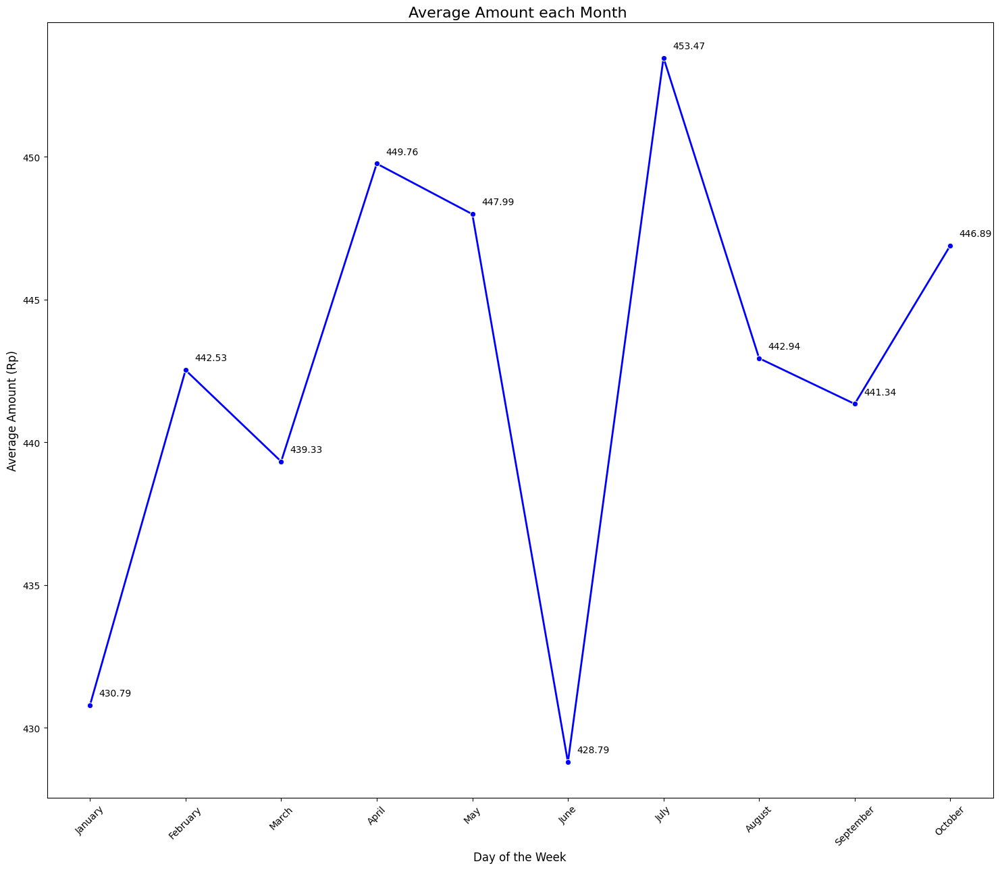

In [ ]:
# Visualisasi lineplot
plt.figure(figsize=(15, 13))
sns.lineplot(data=average_transaction, x="Month Name", y="Transaction Amount", marker="o", color="blue", linewidth=2)

# Menambahkan angka di setiap titik (Opsional)
for x, y in zip(average_transaction['Month Name'], average_transaction['Transaction Amount']):
    plt.annotate(format(y, '.2f'), xy=(x, y), textcoords="offset points", xytext=(27, 10), ha='center', color='black', fontsize=10)

# Menambahkan judul dan label
plt.title("Average Amount each Month ", fontsize=16)
plt.xlabel("Day of the Week", fontsize=12)
plt.ylabel("Average Amount (Rp)", fontsize=12)
plt.xticks(rotation=45)

plt.tight_layout()  # Menghindari elemen terpotong
plt.show()

## Pivot Table, sort index

3. in which category that have a biggest transaction based on gender ?

In [ ]:
new_varians = pd.pivot_table(
    data = df_transaction ,
    index = ['Category','Gender'],
    values = 'Transaction Amount',
    aggfunc = 'mean'
).reset_index().sort_values(by ='Transaction Amount', ascending = False)
new_varians

,Category,Gender,Transaction Amount
10,Travel,F,1549.420924
11,Travel,M,1528.008947
5,Electronics,M,533.157401
4,Electronics,F,523.578408
6,Market,F,257.062509
7,Market,M,256.112235
0,Clothing,F,160.147661
1,Clothing,M,159.174585
2,Cosmetic,F,106.607677
3,Cosmetic,M,106.028407


/tmp/ipython-input-33-1889886759.py:6: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:cyan'` for the same effect.

  ax = sns.barplot(data=new_varians, x='Category', y='Transaction Amount', hue = 'Gender', color='cyan')


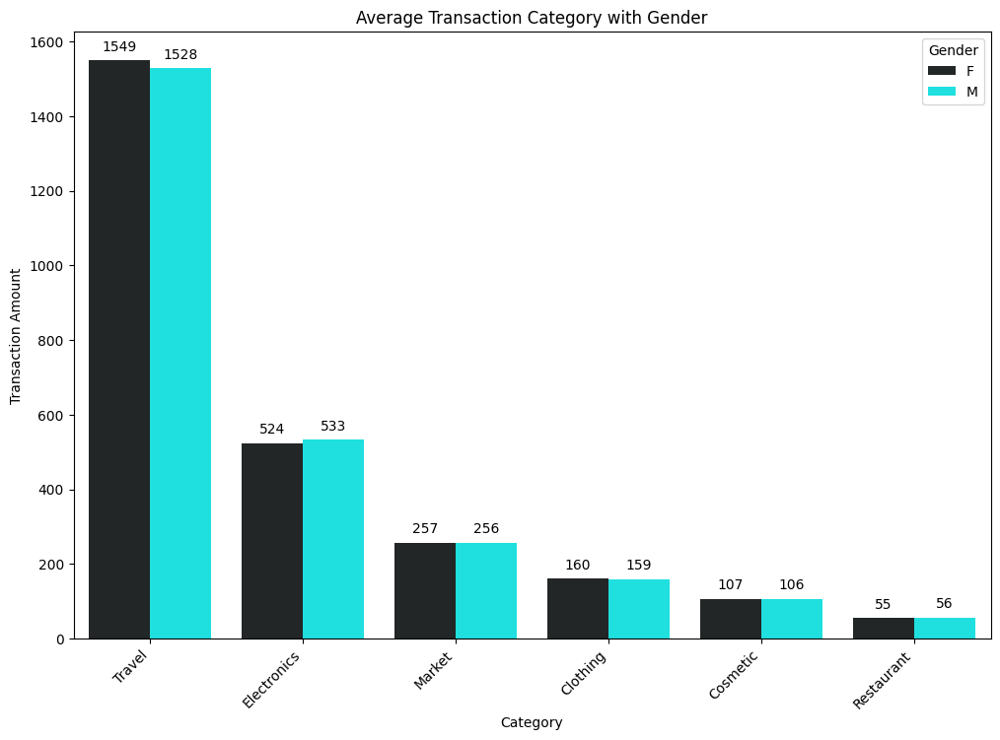

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(12, 8))

ax = sns.barplot(data=new_varians, x='Category', y='Transaction Amount', hue = 'Gender', color='cyan')

# Set the title and labels
plt.title('Average Transaction Category with Gender')
plt.xlabel('Category')
plt.ylabel('Transaction Amount')
plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.annotate(
            text=format(height, '.0f'),
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black'
        )
                #font = 'monospace')

 4. in which month that have the highest customer for customer ID ?

In [ ]:
buyer = df_transaction.groupby("Month Name")["Customer ID"].count().reset_index()
buyer

,Month Name,Customer ID
0,April,5091
1,August,5399
2,February,4854
3,January,5444
4,July,5458
5,June,5258
6,March,5456
7,May,5493
8,October,2394
9,September,5153


In [ ]:
# Urutan bulan sesuai kalender
month_order = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']

# Mengatur kolom 'Month Name' sebagai kategori terurut
buyer['Month Name'] = pd.Categorical(buyer['Month Name'],
                                                   categories=month_order,
                                                   ordered=True)

# Mengurutkan dataframe berdasarkan urutan bulan
buyer = buyer.sort_values('Month Name')
buyer

,Month Name,Customer ID
3,January,5444
2,February,4854
6,March,5456
0,April,5091
7,May,5493
5,June,5258
4,July,5458
1,August,5399
9,September,5153
8,October,2394


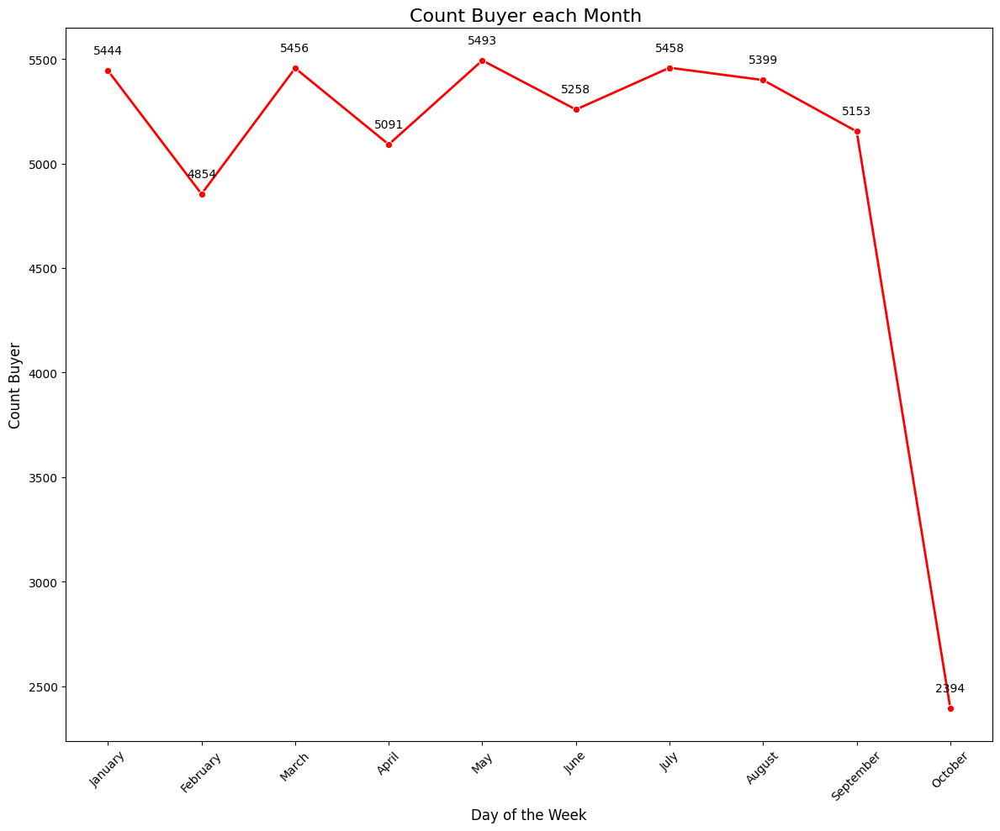

In [ ]:
# Visualisasi lineplot
plt.figure(figsize=(12,10))
sns.lineplot(data=buyer, x="Month Name", y="Customer ID", marker="o", color="red", linewidth=2)

# Menambahkan angka di setiap titik (Opsional)
for x, y in zip(buyer['Month Name'], buyer['Customer ID']):
    plt.annotate(format(y, '.0f'), xy=(x, y), textcoords="offset pixels", xytext=(0, 20), ha='center', color='black', fontsize=10)

# Menambahkan judul dan label
plt.title("Count Buyer each Month ", fontsize=16)
plt.xlabel("Day of the Week", fontsize=12)
plt.ylabel("Count Buyer", fontsize=12)
plt.xticks(rotation=45)

plt.tight_layout()  # Menghindari elemen terpotong
plt.show()

# Table Age

In [ ]:
df_age = df_transaction.copy()
df_age.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category,DayOfWeek,Year,Year_People,Day,Month Name,Day Month
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic,Monday,2023,2002,3,April,April 3
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel,Monday,2023,1985,17,July,July 17
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing,Wednesday,2023,1981,20,September,September 20
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Wednesday,2023,1977,11,January,January 11
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics,Tuesday,2023,1951,13,June,June 13


In [ ]:
# making a new column for knowing the age
df_age['Age'] = df_age['Year'] - df_age['Year_People']
df_age.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category,DayOfWeek,Year,Year_People,Day,Month Name,Day Month,Age
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic,Monday,2023,2002,3,April,April 3,21
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel,Monday,2023,1985,17,July,July 17,38
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing,Wednesday,2023,1981,20,September,September 20,42
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Wednesday,2023,1977,11,January,January 11,46
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics,Tuesday,2023,1951,13,June,June 13,72


In [ ]:
# making a new column to join the name and surname in one column
df_age['Real Name'] = df_age[['Name', 'Surname']].apply(lambda x: ' '.join(x), axis=1)
df_age.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category,DayOfWeek,Year,Year_People,Day,Month Name,Day Month,Age,Real Name
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic,Monday,2023,2002,3,April,April 3,21,Sean Rodriguez
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel,Monday,2023,1985,17,July,July 17,38,Michelle Phelps
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing,Wednesday,2023,1981,20,September,September 20,42,Jacob Williams
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Wednesday,2023,1977,11,January,January 11,46,Nathan Snyder
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics,Tuesday,2023,1951,13,June,June 13,72,Crystal Knapp


In [ ]:
# making definition to determine the range of age into group
def umur(x):
  if x <= 20:
    return 'Group <= 20'
  elif x <= 40:
    return 'Group 21 - 40'
  elif x <= 60:
    return 'Group 41 - 60'
  else:
    return 'Group > 60'

In [ ]:
df_age['Age Group'] = df_age['Age'].apply(umur)
df_age.head()

,Customer ID,Name,Surname,Gender,Birthdate,Transaction Amount,Date,Merchant Name,Category,DayOfWeek,Year,Year_People,Day,Month Name,Day Month,Age,Real Name,Age Group
0,752858,Sean,Rodriguez,F,2002-10-20,35.47,2023-04-03,Smith-Russell,Cosmetic,Monday,2023,2002,3,April,April 3,21,Sean Rodriguez,Group 21 - 40
1,26381,Michelle,Phelps,F,1985-10-24,2552.72,2023-07-17,"Peck, Spence and Young",Travel,Monday,2023,1985,17,July,July 17,38,Michelle Phelps,Group 21 - 40
2,305449,Jacob,Williams,M,1981-10-25,115.97,2023-09-20,Steele Inc,Clothing,Wednesday,2023,1981,20,September,September 20,42,Jacob Williams,Group 41 - 60
3,988259,Nathan,Snyder,M,1977-10-26,11.31,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Wednesday,2023,1977,11,January,January 11,46,Nathan Snyder,Group 41 - 60
4,764762,Crystal,Knapp,F,1951-11-02,62.21,2023-06-13,Palmer-Hinton,Electronics,Tuesday,2023,1951,13,June,June 13,72,Crystal Knapp,Group > 60


In [ ]:
df_age_extract = df_age[['Customer ID', 'Real Name', 'Gender', 'Transaction Amount', 'Age', 'Date', 'Year', 'Month Name', 'Merchant Name', 'Category', 'Age Group']]
df_age_extract.head()

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Year,Month Name,Merchant Name,Category,Age Group
0,752858,Sean Rodriguez,F,35.47,21,2023-04-03,2023,April,Smith-Russell,Cosmetic,Group 21 - 40
1,26381,Michelle Phelps,F,2552.72,38,2023-07-17,2023,July,"Peck, Spence and Young",Travel,Group 21 - 40
2,305449,Jacob Williams,M,115.97,42,2023-09-20,2023,September,Steele Inc,Clothing,Group 41 - 60
3,988259,Nathan Snyder,M,11.31,46,2023-01-11,2023,January,"Wilson, Wilson and Russell",Cosmetic,Group 41 - 60
4,764762,Crystal Knapp,F,62.21,72,2023-06-13,2023,June,Palmer-Hinton,Electronics,Group > 60


In [ ]:
a = df_age_extract['Transaction Amount']
np.percentile(a, 50)

np.float64(182.195)

In [ ]:
a.quantile(0.5)

np.float64(182.195)

# Tabel RFM

In [ ]:
df_rfm = df_age_extract.groupby('Real Name').agg(Last_Transaction = ('Date','max') , Frequency = ('Customer ID', 'nunique') , Monetary = ('Transaction Amount', 'sum')).reset_index()
df_rfm.head(10)

,Real Name,Last_Transaction,Frequency,Monetary
0,Aaron Adams,2023-10-05,2,1173.85
1,Aaron Allen,2023-08-10,2,159.52
2,Aaron Andrews,2023-07-17,1,119.70
3,Aaron Archer,2023-02-25,1,276.96
4,Aaron Armstrong,2023-02-24,1,2300.65
5,Aaron Arroyo,2023-09-23,1,589.22
6,Aaron Baldwin,2023-01-06,1,10.33
7,Aaron Barber,2023-04-22,1,120.00
8,Aaron Barker,2023-09-06,1,124.48
9,Aaron Barnes,2023-09-27,2,422.76


In [ ]:
from datetime import date
df_rfm['Today Date'] = date.today()
df_rfm['Today Date']= pd.to_datetime(df_rfm['Today Date'])
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22


In [ ]:
df_rfm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39545 entries, 0 to 39544
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Real Name         39545 non-null  object        
 1   Last_Transaction  39545 non-null  datetime64[ns]
 2   Frequency         39545 non-null  int64         
 3   Monetary          39545 non-null  float64       
 4   Today Date        39545 non-null  datetime64[ns]
dtypes: datetime64[ns](2), float64(1), int64(1), object(1)
memory usage: 1.5+ MB


In [ ]:
df_rfm['Recency'] = df_rfm['Today Date'] - df_rfm['Last_Transaction']
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days


In [ ]:
q1 = df_rfm['Recency'].quantile(0.20)
q2 = df_rfm['Recency'].quantile(0.40)
q3 = df_rfm['Recency'].quantile(0.60)
q4 = df_rfm['Recency'].quantile(0.80)

def r_score(x):
    if x <= q1:
        return 5
    elif x <= q2:
        return 4
    elif x <= q3:
        return 3
    elif x <= q4:
        return 2
    else:
        return 1

In [ ]:
# Hitung quantile sekali saja
#quantiles = df_rfm['Recency'].quantile([0.20, 0.40, 0.60, 0.80])
# Terapkan fungsi ke kolom 'Recency'
df_rfm['R Score'] = df_rfm['Recency'].apply(r_score)
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days,5
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days,4
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days,4
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days,1
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days,1


In [ ]:
#q11 = df_rfm['Frequency'].quantile(0.80)
#q21 = df_rfm['Frequency'].quantile(0.60)
#q31 = df_rfm['Frequency'].quantile(0.40)
#q41 = df_rfm['Frequency'].quantile(0.20)

def f_score(x):
    if x >= 8:
        return 5
    elif x >= 6:
        return 4
    elif x >= 4:
        return 3
    elif x >= 2:
        return 2
    else:
        return 1

In [ ]:
# Terapkan fungsi ke kolom 'Recency'
df_rfm['F Score'] = df_rfm['Frequency'].apply(f_score)
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score,F Score
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days,5,2
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days,4,2
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days,4,1
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days,1,1
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days,1,1


In [ ]:
q12 = df_rfm['Monetary'].quantile(0.80)
q22 = df_rfm['Monetary'].quantile(0.60)
q32 = df_rfm['Monetary'].quantile(0.40)
q42 = df_rfm['Monetary'].quantile(0.20)

def m_score(x):
    if x >= q12:
        return 5
    elif x >= q22:
        return 4
    elif x >= q32:
        return 3
    elif x >= q42:
        return 2
    else:
        return 1

In [ ]:
# Hitung quantile sekali saja
#quantiles_2 = df_rfm['Monetary'].quantile([0.20, 0.40, 0.60, 0.80])

# Terapkan fungsi ke kolom 'Recency'
df_rfm['M Score'] = df_rfm['Monetary'].apply(m_score)
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score,F Score,M Score
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days,5,2,5
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days,4,2,2
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days,4,1,2
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days,1,1,3
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days,1,1,5


In [ ]:
df_rfm['RFM Score'] = df_rfm['R Score'].astype(str) + df_rfm['F Score'].astype(str) + df_rfm['M Score'].astype(str)
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score,F Score,M Score,RFM Score
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days,5,2,5,525
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days,4,2,2,422
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days,4,1,2,412
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days,1,1,3,113
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days,1,1,5,115


In [ ]:
def customer_segment(x):
  if x <= '555' and x >= '511':
    return 'Super Royal'
  elif x >= '451' and x <= '510':
    return 'Loyal'
  elif x >= '351' and x <= '450':
    return 'Member'
  elif x >= '151' and x <= '350':
    return 'Poor'
  else:
    return 'Uncategorized'

In [ ]:
df_rfm['Customer Segment'] = df_rfm['RFM Score'].apply(customer_segment)
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score,F Score,M Score,RFM Score,Customer Segment
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-22,595 days,5,2,5,525,Super Royal
1,Aaron Allen,2023-08-10,2,159.52,2025-05-22,651 days,4,2,2,422,Member
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-22,675 days,4,1,2,412,Member
3,Aaron Archer,2023-02-25,1,276.96,2025-05-22,817 days,1,1,3,113,Uncategorized
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-22,818 days,1,1,5,115,Uncategorized


In [ ]:
df_rfm_1 = df_rfm[['Real Name', 'Recency', 'Frequency', 'Monetary', 'RFM Score', 'Customer Segment']]
df_rfm_1.head()

,Real Name,Recency,Frequency,Monetary,RFM Score,Customer Segment
0,Aaron Adams,595 days,2,1173.85,525,Super Royal
1,Aaron Allen,651 days,2,159.52,422,Member
2,Aaron Andrews,675 days,1,119.70,412,Member
3,Aaron Archer,817 days,1,276.96,113,Uncategorized
4,Aaron Armstrong,818 days,1,2300.65,115,Uncategorized


In [ ]:
df_rfm_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39545 entries, 0 to 39544
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype          
---  ------            --------------  -----          
 0   Real Name         39545 non-null  object         
 1   Recency           39545 non-null  timedelta64[ns]
 2   Frequency         39545 non-null  int64          
 3   Monetary          39545 non-null  float64        
 4   RFM Score         39545 non-null  object         
 5   Customer Segment  39545 non-null  object         
dtypes: float64(1), int64(1), object(3), timedelta64[ns](1)
memory usage: 1.8+ MB


In [ ]:
df_combine = pd.merge(df_age_extract,df_rfm_1, on='Real Name', how = 'left')
df_combine.head(20)

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Merchant Name,Category,Age Group,Recency,Frequency,Monetary,RFM Score,Customer Segment
0,752858,Sean Rodriguez,F,35.47,21,2023-04-03,Smith-Russell,Cosmetic,Group 21 - 40,780 days,1,35.47,211,Poor
1,26381,Michelle Phelps,F,2552.72,38,2023-07-17,"Peck, Spence and Young",Travel,Group 21 - 40,675 days,1,2552.72,415,Member
2,305449,Jacob Williams,M,115.97,42,2023-09-20,Steele Inc,Clothing,Group 41 - 60,610 days,1,115.97,512,Super Royal
3,988259,Nathan Snyder,M,11.31,46,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Group 41 - 60,673 days,2,458.67,424,Member
4,764762,Crystal Knapp,F,62.21,72,2023-06-13,Palmer-Hinton,Electronics,Group > 60,709 days,2,377.93,324,Poor
5,576539,Monica Bartlett,F,99.14,22,2023-08-24,"Tran, Torres and Joyce",Cosmetic,Group 21 - 40,637 days,1,99.14,412,Member
6,124681,Thomas Shaw,F,145.94,47,2023-08-30,"Evans, Griffin and Torres",Cosmetic,Group 41 - 60,631 days,2,896.98,525,Super Royal
7,521807,Kelsey Pena,F,161.39,55,2023-02-08,Miller PLC,Cosmetic,Group 41 - 60,834 days,1,161.39,112,Uncategorized
8,504238,Denise Porter,M,77.73,66,2023-01-12,Jackson-Morgan,Restaurant,Group > 60,861 days,1,77.73,112,Uncategorized
9,583532,Alexander Richardson,F,142.85,49,2023-06-07,"Blake, Mays and Anderson",Clothing,Group 41 - 60,715 days,1,142.85,312,Poor


In [ ]:
df_combine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype          
---  ------              --------------  -----          
 0   Customer ID         50000 non-null  int64          
 1   Real Name           50000 non-null  object         
 2   Gender              50000 non-null  object         
 3   Transaction Amount  50000 non-null  float64        
 4   Age                 50000 non-null  int32          
 5   Date                50000 non-null  datetime64[ns] 
 6   Merchant Name       50000 non-null  object         
 7   Category            50000 non-null  object         
 8   Age Group           50000 non-null  object         
 9   Recency             50000 non-null  timedelta64[ns]
 10  Frequency           50000 non-null  int64          
 11  Monetary            50000 non-null  float64        
 12  RFM Score           50000 non-null  object         
 13  Customer Segment    50000 non-n

# Business Problem
1. In which group age that have the highest total transaction based on gender ?
2. Which one of customer segment that have the highest count of customer ?
3. From 2023, which date that have the highest count of customer ?
4. In which category that have the highest transaction ? How many on them based on gender  ?
5. Who is the customer get the highest total of monetary ?


Answer :
1. In which group age that have the highest total transaction based on gender ?

In [ ]:
age = pd.pivot_table(
    data = df_combine ,
    index = ['Age Group','Gender'],
    values = 'Transaction Amount',
    aggfunc = 'sum'
).reset_index().sort_values(by ='Transaction Amount', ascending = False)
age

,Age Group,Gender,Transaction Amount
2,Group 41 - 60,F,4262612.60
0,Group 21 - 40,F,4200047.95
1,Group 21 - 40,M,3335670.24
3,Group 41 - 60,M,3329091.69
6,Group > 60,F,3179471.94
7,Group > 60,M,2607968.83
4,Group <= 20,F,668946.67
5,Group <= 20,M,522152.05


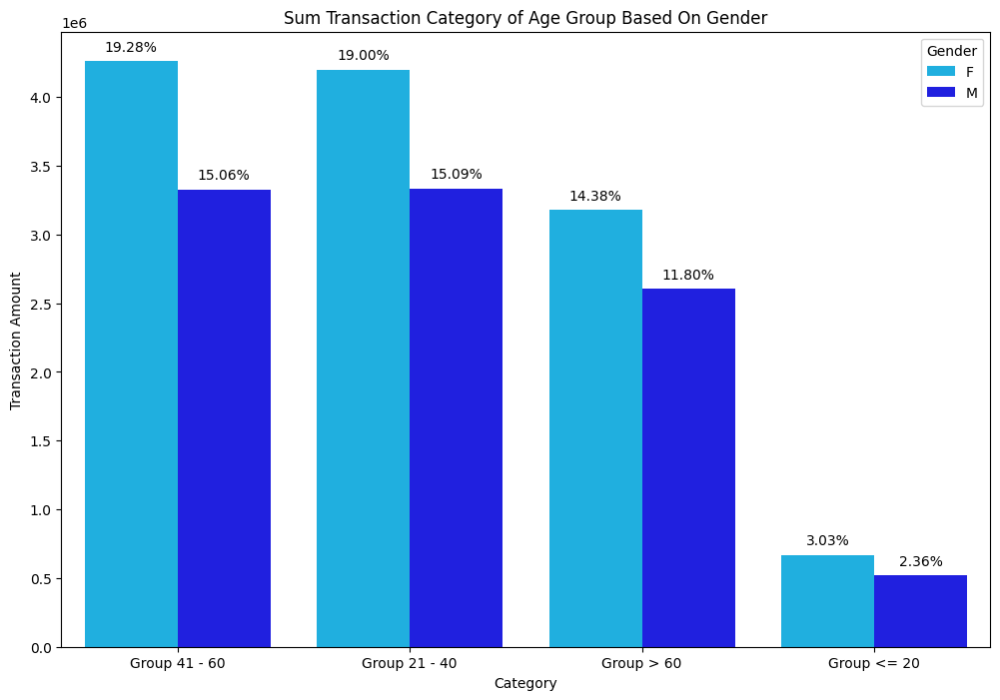

In [ ]:
plt.figure(figsize=(12, 8))
total_amount = age['Transaction Amount'].sum()

ax = sns.barplot(data = age, x='Age Group', y='Transaction Amount', hue = 'Gender', color='cyan', palette={'F':'deepskyblue', 'M':'blue'})

# Set the title and labels
plt.title('Sum Transaction Category of Age Group Based On Gender')
plt.xlabel('Category')
plt.ylabel('Transaction Amount')
#plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / total_amount) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black'
        )

2. Which one of customer segment that have the highest count of customer ?

In [ ]:
segment = pd.pivot_table(
    data = df_combine ,
    index = 'Customer Segment',
    values = 'Customer ID',
    aggfunc = 'nunique'
).reset_index().sort_values(by ='Customer ID', ascending = False)
segment

,Customer Segment,Customer ID
2,Poor,18340
3,Super Royal,12818
1,Member,10522
4,Uncategorized,8097
0,Loyal,223


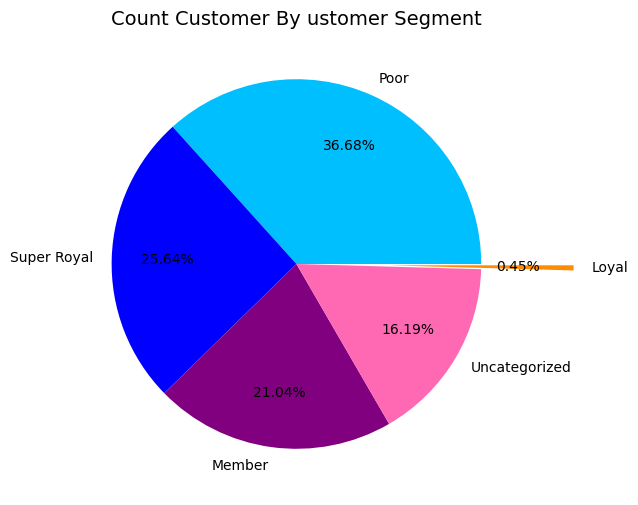

In [ ]:
fig = plt.subplots(figsize=(10, 6)) # membuat grafik pie chart terhadap customer churn dan tidak
bagian = segment['Customer Segment']
#weight = [2,3,2,3,2]
weight = segment['Customer ID']

plt.pie(
    x = weight,
    labels = bagian,
    autopct='%.2f%%',
    pctdistance=0.7,
    #weights = weight,
    colors = ['deepskyblue', 'blue', 'purple', 'hotpink', 'darkorange'],
    #autopct = lambda p: f'{p * sum(x) / 100:.2f}',
    #wedgeprops=dict(width=0.5, edgecolor='black'),
    explode=[0, 0, 0, 0, 0.5]  # Memisahkan bagian kecil (Loyal)
)
plt.title('Count Customer By ustomer Segment', fontsize = 14)
plt.show()

3. From 2023, which date that have the highest count of customer in 3 or 2 months last ?

In [ ]:
df_combine.head()

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Merchant Name,Category,Age Group,Recency,Frequency,Monetary,RFM Score,Customer Segment
0,752858,Sean Rodriguez,F,35.47,21,2023-04-03,Smith-Russell,Cosmetic,Group 21 - 40,779 days,1,35.47,211,Poor
1,26381,Michelle Phelps,F,2552.72,38,2023-07-17,"Peck, Spence and Young",Travel,Group 21 - 40,674 days,1,2552.72,415,Member
2,305449,Jacob Williams,M,115.97,42,2023-09-20,Steele Inc,Clothing,Group 41 - 60,609 days,1,115.97,512,Super Royal
3,988259,Nathan Snyder,M,11.31,46,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Group 41 - 60,672 days,2,458.67,424,Member
4,764762,Crystal Knapp,F,62.21,72,2023-06-13,Palmer-Hinton,Electronics,Group > 60,708 days,2,377.93,324,Poor


In [ ]:
df_combine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype          
---  ------              --------------  -----          
 0   Customer ID         50000 non-null  int64          
 1   Real Name           50000 non-null  object         
 2   Gender              50000 non-null  object         
 3   Transaction Amount  50000 non-null  float64        
 4   Age                 50000 non-null  int32          
 5   Date                50000 non-null  datetime64[ns] 
 6   Merchant Name       50000 non-null  object         
 7   Category            50000 non-null  object         
 8   Age Group           50000 non-null  object         
 9   Recency             50000 non-null  timedelta64[ns]
 10  Frequency           50000 non-null  int64          
 11  Monetary            50000 non-null  float64        
 12  RFM Score           50000 non-null  object         
 13  Customer Segment    50000 non-n

In [ ]:
df_combine['Month Name'] = pd.DatetimeIndex(df_combine['Date']).month_name()
df_combine['Day Month Baru'] = df_combine['Date'].dt.strftime('%B %d')
df_combine.head()

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Merchant Name,Category,Age Group,Recency,Frequency,Monetary,RFM Score,Customer Segment,Month Name,Day Month Baru
0,752858,Sean Rodriguez,F,35.47,21,2023-04-03,Smith-Russell,Cosmetic,Group 21 - 40,779 days,1,35.47,211,Poor,April,April 03
1,26381,Michelle Phelps,F,2552.72,38,2023-07-17,"Peck, Spence and Young",Travel,Group 21 - 40,674 days,1,2552.72,415,Member,July,July 17
2,305449,Jacob Williams,M,115.97,42,2023-09-20,Steele Inc,Clothing,Group 41 - 60,609 days,1,115.97,512,Super Royal,September,September 20
3,988259,Nathan Snyder,M,11.31,46,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Group 41 - 60,672 days,2,458.67,424,Member,January,January 11
4,764762,Crystal Knapp,F,62.21,72,2023-06-13,Palmer-Hinton,Electronics,Group > 60,708 days,2,377.93,324,Poor,June,June 13


In [ ]:
filter = df_combine[df_combine['Month Name'].isin(['October', 'September', 'August'])]
filter.head()

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Merchant Name,Category,Age Group,Recency,Frequency,Monetary,RFM Score,Customer Segment,Month Name,Day Month Baru
2,305449,Jacob Williams,M,115.97,42,2023-09-20,Steele Inc,Clothing,Group 41 - 60,609 days,1,115.97,512,Super Royal,September,September 20
5,576539,Monica Bartlett,F,99.14,22,2023-08-24,"Tran, Torres and Joyce",Cosmetic,Group 21 - 40,636 days,1,99.14,412,Member,August,August 24
6,124681,Thomas Shaw,F,145.94,47,2023-08-30,"Evans, Griffin and Torres",Cosmetic,Group 41 - 60,630 days,2,896.98,525,Super Royal,August,August 30
11,123235,Hunter Peters,M,387.78,52,2023-09-24,"Barker, Ortiz and Cox",Market,Group 41 - 60,605 days,1,387.78,514,Super Royal,September,September 24
12,840546,Julie Russell,M,142.07,55,2023-08-07,Taylor-Morrow,Cosmetic,Group 41 - 60,653 days,1,142.07,412,Member,August,August 07


In [ ]:
# Tambahkan kolom datetime baru dengan tahun dummy (misalnya 2023)
#filter['Day Month Date'] = pd.to_datetime(filter['Day Month Baru'] + ' 2023', format='%B %d %Y')

# Pivot table
date = pd.pivot_table(
    data = filter,
    index = 'Day Month Baru',
    values = 'Customer ID',
    aggfunc = 'nunique'
).reset_index()

# Gabungkan dengan kolom datetime untuk keperluan sorting
date['Day Month Date'] = pd.to_datetime(date['Day Month Baru'] + ' 2023', format='%B %d %Y')

# Sort berdasarkan tanggal, bukan string
date = date.sort_values(by='Day Month Date').reset_index(drop=True).tail(20)

# (Opsional) Drop kolom bantu
#date = date.drop(columns=['Day Month Date'])

# Tampilkan hasil
date

,Day Month Baru,Customer ID,Day Month Date
55,September 25,158,2023-09-25
56,September 26,157,2023-09-26
57,September 27,181,2023-09-27
58,September 28,162,2023-09-28
59,September 29,163,2023-09-29
60,September 30,169,2023-09-30
61,October 01,179,2023-10-01
62,October 02,154,2023-10-02
63,October 03,167,2023-10-03
64,October 04,192,2023-10-04


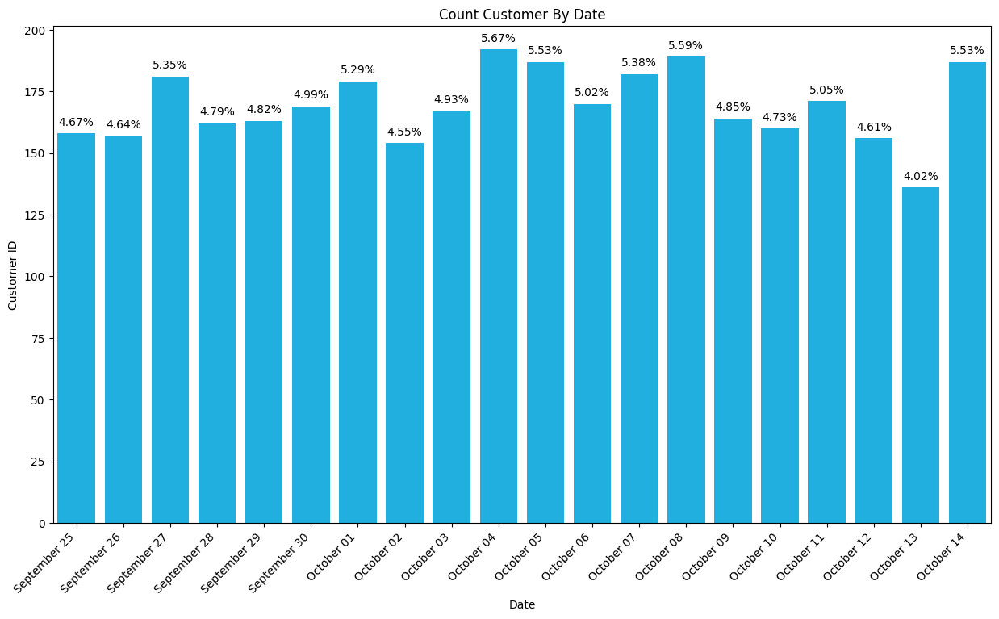

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(15,8))
count_customer = date['Customer ID'].sum()

ax = sns.barplot(data= date, x='Day Month Baru', y='Customer ID', color='deepskyblue')

# Set the title and labels
plt.title('Count Customer By Date')
plt.xlabel('Date')
plt.ylabel('Customer ID')
plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / count_customer) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black'
        )
                #font = 'monospace')

4. In which category that have the highest transaction ? How many on them based on gender  ?

In [ ]:
category = pd.pivot_table(
    data = df_combine ,
    index = ['Category','Gender'],
    values = 'Customer ID',
    aggfunc = 'nunique'
).reset_index().sort_values(by ='Customer ID', ascending = False)
category

,Category,Gender,Customer ID
8,Restaurant,F,4719
10,Travel,F,4675
6,Market,F,4632
2,Cosmetic,F,4627
4,Electronics,F,4584
0,Clothing,F,4523
7,Market,M,3750
5,Electronics,M,3740
1,Clothing,M,3738
11,Travel,M,3702


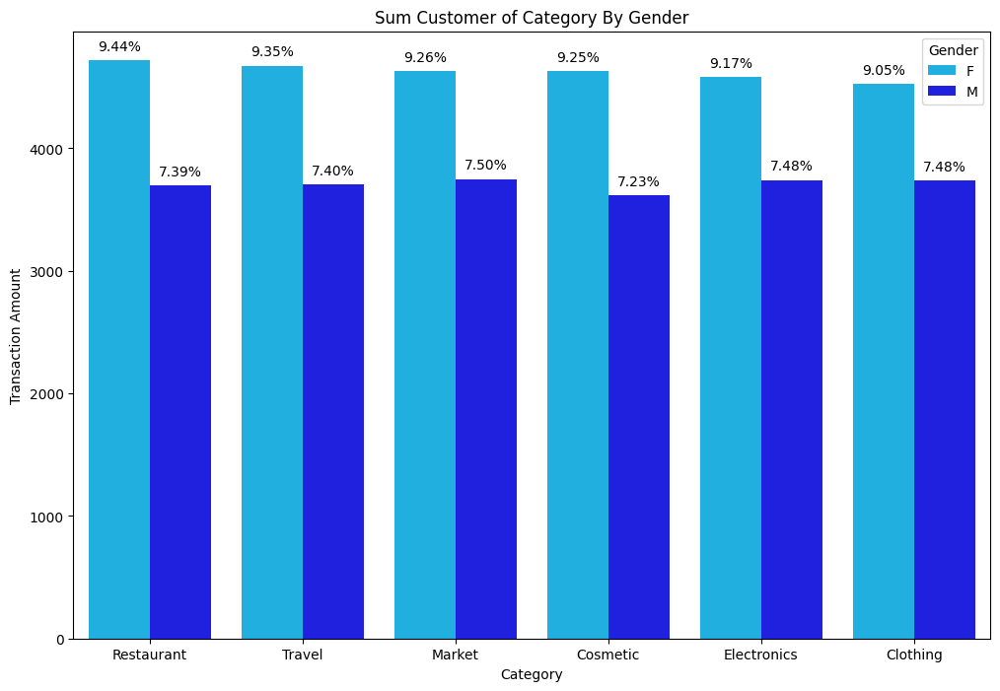

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(12, 8))
count_customer_1 = category['Customer ID'].sum()

ax = sns.barplot(data= category, x='Category', y='Customer ID', hue = 'Gender',  palette={'F':'deepskyblue', 'M':'blue'})

# Set the title and labels
plt.title('Sum Customer of Category By Gender')
plt.xlabel('Category')
plt.ylabel('Transaction Amount')
#plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / count_customer_1) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black'
        )

In [ ]:
Transaction = pd.pivot_table(
    data = df_combine ,
    index = 'Category',
    values = 'Transaction Amount',
    aggfunc = 'sum'
).reset_index().sort_values(by ='Transaction Amount', ascending = False)
Transaction

,Category,Transaction Amount
5,Travel,12900231.94
2,Electronics,4394092.10
3,Market,2151134.42
0,Clothing,1319342.47
1,Cosmetic,876672.44
4,Restaurant,464488.60


In [ ]:
Transaction['Percentage'] = (Transaction['Transaction Amount'] / Transaction['Transaction Amount'].sum()) * 100
Transaction

,Category,Transaction Amount,Percentage
5,Travel,12900231.94,58.356347
2,Electronics,4394092.10,19.877407
3,Market,2151134.42,9.731015
0,Clothing,1319342.47,5.968265
1,Cosmetic,876672.44,3.965774
4,Restaurant,464488.60,2.101192


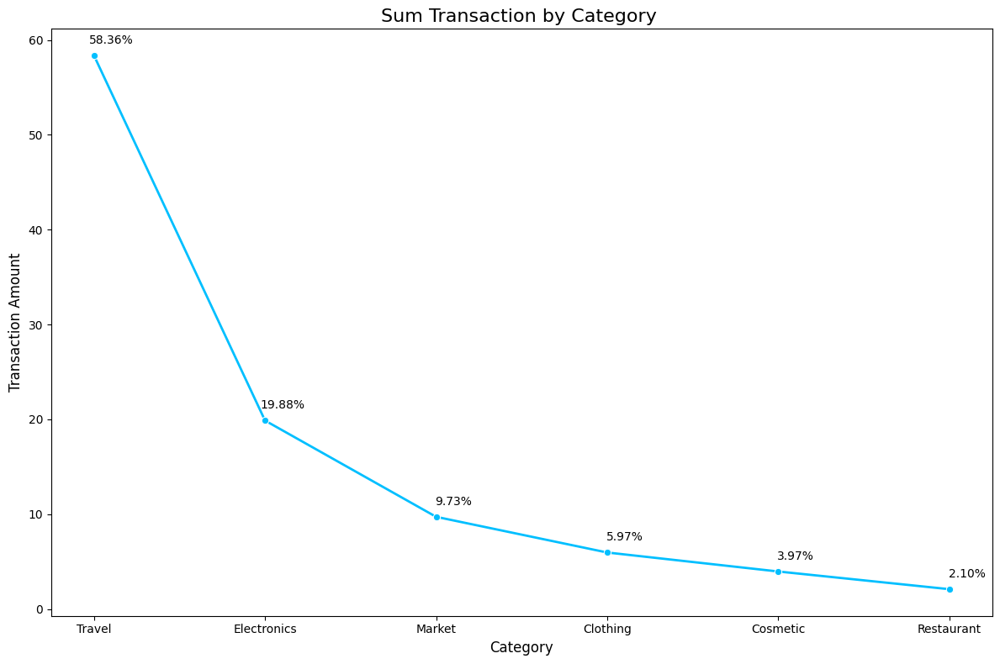

In [ ]:
# Visualisasi lineplot
plt.figure(figsize=(12,8))
sns.lineplot(data= Transaction, x="Category", y="Percentage", marker="o", color='deepskyblue', linewidth=2)

# Menambahkan angka di setiap titik (Opsional)
for x, y in zip(Transaction['Category'], Transaction['Percentage']):
    plt.annotate(f"{y:.2f}%", xy=(x, y), textcoords="offset points", xytext=(15, 10), ha='center', color='black', fontsize=10)


# Menambahkan judul dan label
plt.title("Sum Transaction by Category ", fontsize=16)
plt.xlabel("Category", fontsize=12)
plt.ylabel("Transaction Amount", fontsize=12)
#plt.xticks(rotation=45)

plt.tight_layout()  # Menghindari elemen terpotong
plt.show()

5. Who is the customer get the highest total of monetary ?

In [ ]:
df_combine.head()

,Customer ID,Real Name,Gender,Transaction Amount,Age,Date,Merchant Name,Category,Age Group,Recency,Frequency,Monetary,RFM Score,Customer Segment,Month Name,Day Month Baru
0,752858,Sean Rodriguez,F,35.47,21,2023-04-03,Smith-Russell,Cosmetic,Group 21 - 40,779 days,1,35.47,211,Poor,April,April 03
1,26381,Michelle Phelps,F,2552.72,38,2023-07-17,"Peck, Spence and Young",Travel,Group 21 - 40,674 days,1,2552.72,415,Member,July,July 17
2,305449,Jacob Williams,M,115.97,42,2023-09-20,Steele Inc,Clothing,Group 41 - 60,609 days,1,115.97,512,Super Royal,September,September 20
3,988259,Nathan Snyder,M,11.31,46,2023-01-11,"Wilson, Wilson and Russell",Cosmetic,Group 41 - 60,672 days,2,458.67,424,Member,January,January 11
4,764762,Crystal Knapp,F,62.21,72,2023-06-13,Palmer-Hinton,Electronics,Group > 60,708 days,2,377.93,324,Poor,June,June 13


In [ ]:
customer_segment_1 = df_combine.groupby(['Real Name', 'Customer Segment', 'RFM Score']).agg(Recency_Score = ('Recency','sum') , Frequency_Score = ('Frequency', 'sum') , Monetary_Score = ('Monetary', 'sum')).reset_index().sort_values(by = 'Monetary_Score', ascending = False)
customer_segment_1.head(10)

,Real Name,Customer Segment,RFM Score,Recency_Score,Frequency_Score,Monetary_Score
10298,David Smith,Super Royal,555,12936 days,484,420933.26
31983,Robert Smith,Super Royal,555,13984 days,529,284961.26
27693,Michael Smith,Super Royal,555,16464 days,784,244210.12
27480,Michael Johnson,Super Royal,555,11740 days,400,239880.80
27758,Michael Williams,Super Royal,555,12894 days,441,239575.14
26491,Matthew Smith,Loyal,455,9540 days,225,134677.65
27525,Michael Martinez,Super Royal,555,8955 days,225,132547.95
18942,John Smith,Super Royal,555,9536 days,256,132174.56
18632,John Brown,Super Royal,555,8835 days,225,128478.15
15691,James Johnson,Super Royal,555,10353 days,289,115213.42


In [ ]:
df_rfm.head()

,Real Name,Last_Transaction,Frequency,Monetary,Today Date,Recency,R Score,F Score,M Score,RFM Score,Customer Segment
0,Aaron Adams,2023-10-05,2,1173.85,2025-05-21,594 days,5,2,5,525,Super Royal
1,Aaron Allen,2023-08-10,2,159.52,2025-05-21,650 days,4,2,2,422,Member
2,Aaron Andrews,2023-07-17,1,119.70,2025-05-21,674 days,4,1,2,412,Member
3,Aaron Archer,2023-02-25,1,276.96,2025-05-21,816 days,1,1,3,113,Uncategorized
4,Aaron Armstrong,2023-02-24,1,2300.65,2025-05-21,817 days,1,1,5,115,Uncategorized


In [ ]:
df_rfm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39545 entries, 0 to 39544
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype          
---  ------            --------------  -----          
 0   Real Name         39545 non-null  object         
 1   Last_Transaction  39545 non-null  datetime64[ns] 
 2   Frequency         39545 non-null  int64          
 3   Monetary          39545 non-null  float64        
 4   Today Date        39545 non-null  datetime64[ns] 
 5   Recency           39545 non-null  timedelta64[ns]
 6   R Score           39545 non-null  int64          
 7   F Score           39545 non-null  int64          
 8   M Score           39545 non-null  int64          
 9   RFM Score         39545 non-null  object         
 10  Customer Segment  39545 non-null  object         
dtypes: datetime64[ns](2), float64(1), int64(4), object(3), timedelta64[ns](1)
memory usage: 3.3+ MB


In [ ]:
# Where is your data_path
data_path = '/content/drive/MyDrive/Dataset Dibimbing part 2/'
df_age_extract.to_csv(data_path + 'Customer_Transaction(1).csv', index = False)

In [ ]:
# Where is your data_path
data_path = '/content/drive/MyDrive/Dataset Dibimbing part 2/'
df_age_extract.to_csv(data_path + 'Customer_Transaction_New.csv', index = False)

In [ ]:
# Where is your data_path
data_path = '/content/drive/MyDrive/Dataset Dibimbing part 2/'
df_rfm.to_csv(data_path + 'RFMTable(1).csv', index = False)